In [1]:
import sys, os
from time import time
if '../' not in sys.path:
    sys.path.insert(0, '../')

import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

from modules.paths import Experiment

%reload_ext autoreload
%autoreload 2
%matplotlib inline

In [5]:
def show_layer(stack, layer_id=0):
    layer = stack.load_layer(layer_id)
    fig, (ax0, ax1, ax2) = plt.subplots(ncols=3, figsize=(12, 4))
    _ = layer.get_channel('b').show(segments=False, ax=ax0, vmin=0, vmax=1)
    _ = layer.get_channel('r').show(segments=False, ax=ax1, vmin=0, vmax=1)
    _ = layer.get_channel('g').show(segments=False, ax=ax2, vmin=0, vmax=1)
    plt.tight_layout()

In [6]:
# Load paths to each set of experiments
path = '/Volumes/bernasek_t5/pnt_manuscript/microscopy/yan_clones/perturbation/slices/'
genotype = 'w-eyFLP_PntGFP_YanE833_FRT40A_PntGFP_Ubi-mRFPnls_FRT40A'
exp = Experiment(os.path.join(path, genotype))

In [7]:
layers_path = '/Volumes/bernasek_t5/pnt_manuscript/microscopy/yan_clones/layers.xlsx'
dtype = dict(experiment=str, disc_genotype=str, disc_id=int, layer=int, include=bool, region=str)
layers_df = pd.read_excel(layers_path, usecols=6, dtype=dtype)
layers_df.ix[layers_df.include==0, 'region'] = 'n'
df = layers_df[layers_df.disc_genotype==genotype]

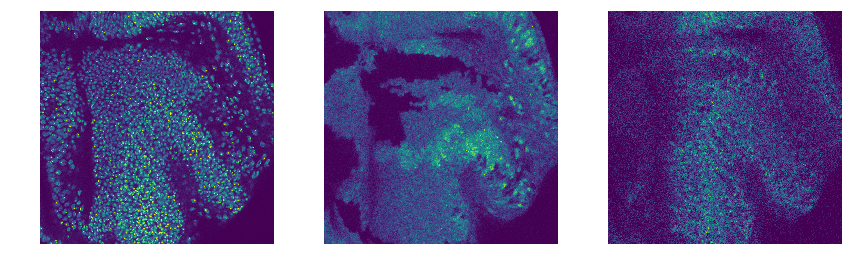

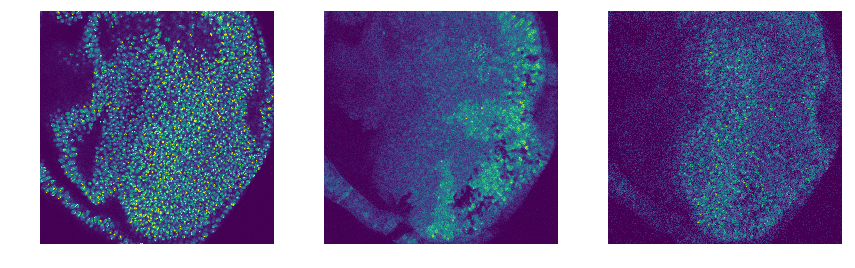

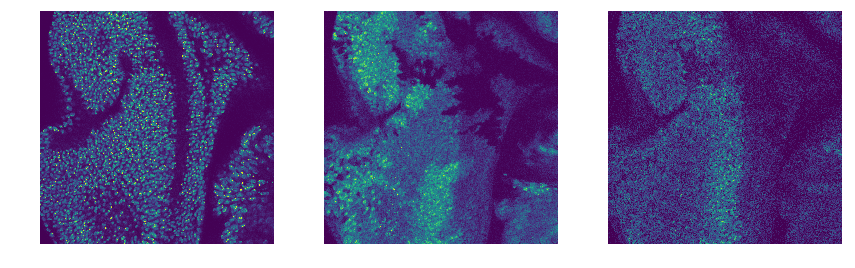

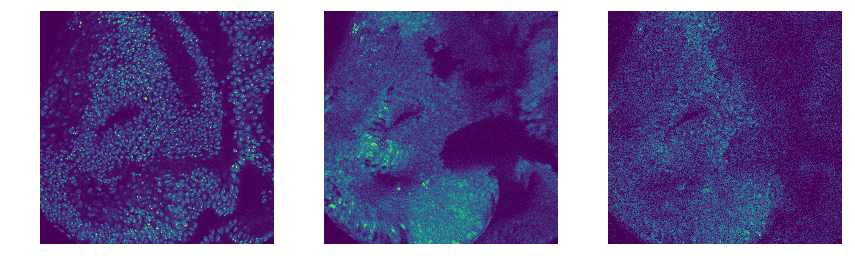

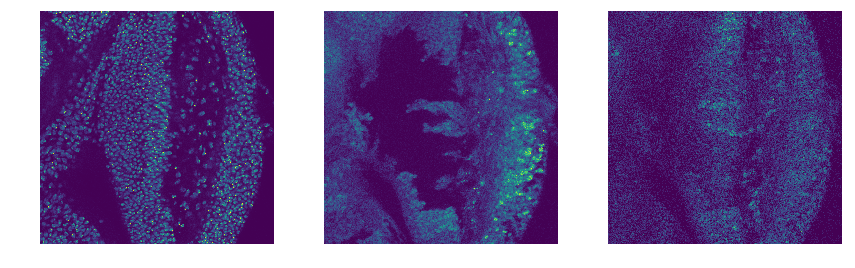

...

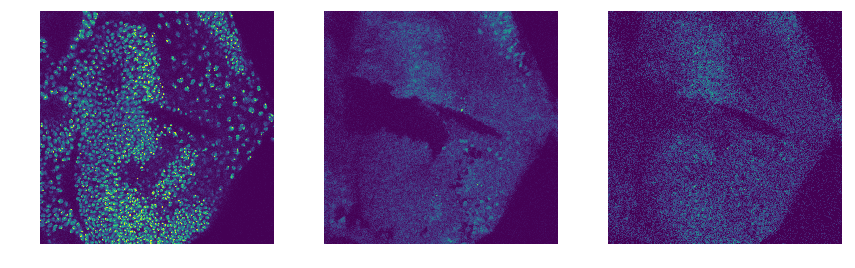

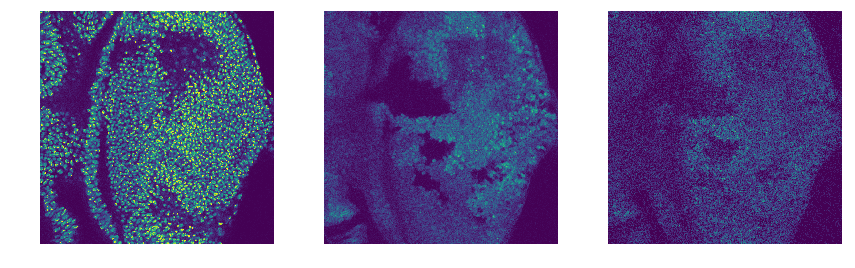

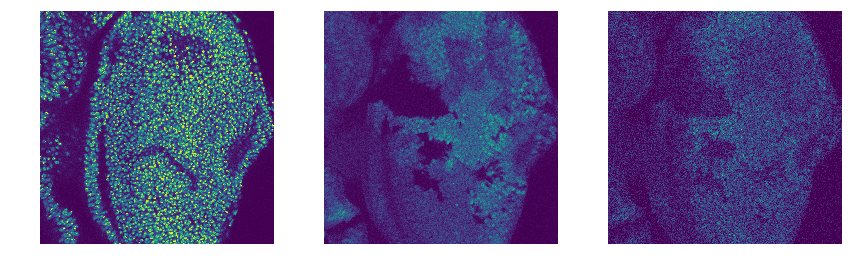

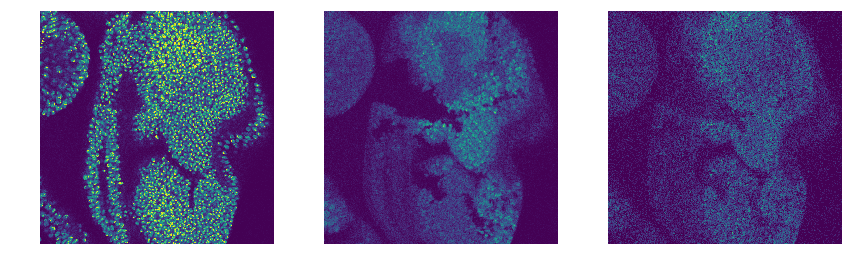

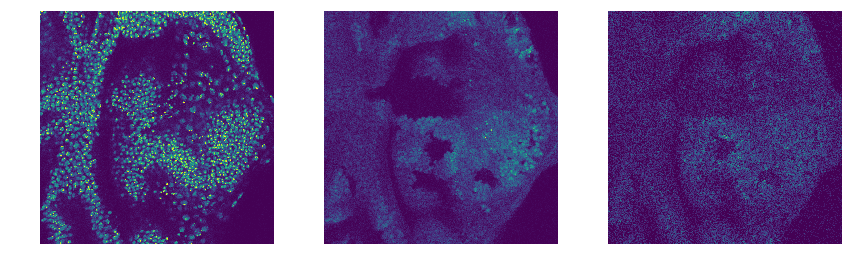

In [8]:
for disc_id in exp.disc_names:
    stack = exp.discs[disc_id].load_stack()
    for layer_id in range(stack.depth):
        include = df[np.logical_and(df.disc_id==disc_id, df.layer==layer_id)].include.values[0]
        if include:
            show_layer(stack, layer_id)